# Part 2 . (CA2.Data_Analystic)
 

In [15]:
# importing packages
import pandas as pd
import numpy as np
import seaborn as sns
import datetime as dt
from cmath import sqrt
import warnings
import matplotlib.pyplot as plt
import datetime
import datetime as dt
import sklearn
#import folium
import warnings
#import pydotplus
import six
import sys
#import statistics as st
#import functions as fn
#import cufflinks as cf

#cf.set_config_file(offline=True)

#prof.to_file(output_file='output.html')
#sys.modules['sklearn.externals.six'] = six
warnings.filterwarnings('ignore')

# import ML packages
import statsmodels.api as sm
from sklearn.linear_model import LinearRegression
from sklearn import datasets, linear_model
from sklearn import metrics
from sklearn.model_selection import cross_val_score
#from scipy import stats
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.cluster import KMeans
from sklearn.preprocessing import LabelEncoder#for train test splitting
from sklearn.model_selection import train_test_split#for decision tree object
from sklearn.tree import DecisionTreeClassifier#for checking testing results
from sklearn.metrics import classification_report, confusion_matrix#for visualizing tree 
from sklearn.tree import plot_tree
from sklearn.tree import export_graphviz
from IPython.display import Image 
from pandas.plotting import scatter_matrix
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
from sklearn.ensemble import RandomForestRegressor
#from explainerdashboard import RegressionExplainer, ExplainerDashboard

#for interactive analysis
from ipywidgets import interact

%matplotlib inline

# Brazil

In [16]:
#Reading in Brazil Crops dataset from between 2010 to 2020 8 actions 10 crop measurements and 139 crop types
brazilagri_crops = pd.read_csv('FAOSTAT_brazil_5-1-2022(4).csv')
brazilagri_crops.head()

,Domain,Area,Element,Item,Year,Unit,Value
0,Crops and livestock products,Brazil,Area harvested,"Almonds, with shell",2010,ha,NaN
1,Crops and livestock products,Brazil,Area harvested,"Almonds, with shell",2011,ha,NaN
2,Crops and livestock products,Brazil,Area harvested,"Almonds, with shell",2012,ha,NaN
3,Crops and livestock products,Brazil,Area harvested,"Almonds, with shell",2013,ha,NaN
4,Crops and livestock products,Brazil,Area harvested,"Almonds, with shell",2014,ha,NaN


In [17]:
#reading the last 5 rows of the dataframe
brazilagri_crops.tail()

,Domain,Area,Element,Item,Year,Unit,Value
3604,Crops and livestock products,Brazil,Production,Yams,2016,tonnes,250020.0
3605,Crops and livestock products,Brazil,Production,Yams,2017,tonnes,250302.0
3606,Crops and livestock products,Brazil,Production,Yams,2018,tonnes,249658.0
3607,Crops and livestock products,Brazil,Production,Yams,2019,tonnes,249963.0
3608,Crops and livestock products,Brazil,Production,Yams,2020,tonnes,250268.0


In [18]:
# inspect description of variables min max and median and quartiles of numeric features
brazilagri_crops.describe()

,Year,Value
count,3609.000000,3.543000e+03
mean,2014.956498,6.041652e+06
std,3.142415,4.418283e+07
min,2010.000000,0.000000e+00
25%,2012.000000,1.412550e+04
50%,2015.000000,1.004600e+05
75%,2018.000000,8.987605e+05
max,2020.000000,7.685942e+08


In [19]:
# inspect dataset information and datatypes
brazilagri_crops.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3609 entries, 0 to 3608
Data columns (total 7 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Domain   3609 non-null   object 
 1   Area     3609 non-null   object 
 2   Element  3609 non-null   object 
 3   Item     3609 non-null   object 
 4   Year     3609 non-null   int64  
 5   Unit     3609 non-null   object 
 6   Value    3543 non-null   float64
dtypes: float64(1), int64(1), object(5)
memory usage: 197.5+ KB


In [20]:
# remove nan or missing values from multiple columns before I merge
brazilagri_crops =  brazilagri_crops.dropna()
brazilagri_crops.head()

,Domain,Area,Element,Item,Year,Unit,Value
22,Crops and livestock products,Brazil,Area harvested,Apples,2010,ha,38723.0
23,Crops and livestock products,Brazil,Area harvested,Apples,2011,ha,38077.0
24,Crops and livestock products,Brazil,Area harvested,Apples,2012,ha,38688.0
25,Crops and livestock products,Brazil,Area harvested,Apples,2013,ha,38284.0
26,Crops and livestock products,Brazil,Area harvested,Apples,2014,ha,37041.0


In [21]:
# Get the shape of the irish crops dataset before we merge
brazilagri_crops.shape

(3543, 7)

# I am concentrating on crops so I have removed livestock and non crops that appear under the column item

In [22]:
# Dropping the rows of all rows under item that do not contain crops but contain livestock etc.
brazilagri_crops= brazilagri_crops[brazilagri_crops["Item"].str.contains("Asses|Beer of barley|Cattle|skimmed cow milk|Cheese, whole cow milk|Chickens|Cream fresh|Ducks|Eggs, hen, in shell|Fat, cattle|Fat, pigs|Fat, sheep|Geese and guinea fowls|Goats|Hides, cattle, fresh|Honey, natural|Hops|Horses|Lard|Margarine, short|Meat nes|Meat, cattle|Meat, chicken|Meat, duck Meat, goose and guinea fowl|Meat, horse|Meat, pig|Meat, sheep|Meat, turkey|Milk, skimmed cow|Milk, skimmed dried|Milk, whole condensed|Milk, whole dried|Milk, whole evaporated|Milk, whole fresh cow|Mules|Offals, edible, cattle|Offals, horses|Offals, pigs, edible|Offals, sheep,edible|Oil, coconut (copra)|Oil, cottonseed|Oil, groundnut|Oil, linseed|Oil, palm kernel|Oil, rapeseed|Oil, soybean|Pigs|Rapeseed|Sheep|Skins, sheep, fresh|Sugar Raw Centrifugal|Tallow|Turkeys|fresh nes|Whey, condensed|Wool, greasy|Molasses|Almonds, with shell|Buffaloes|Cottonseed|Fat, goats|Hemp tow waste|Meat, goat|Milk, whole fresh buffalo|Milk, whole fresh goat|Milk, whole fresh sheep|Offals, edible, goats|paddy (rice milled equivalent)|Skins, goat, fresh|Sorghum|Tobacco, unmanufactured|Triticale|Meat, duck|Meat, goose and guinea fowl") == False]
# display
brazilagri_crops

,Domain,Area,Element,Item,Year,Unit,Value
22,Crops and livestock products,Brazil,Area harvested,Apples,2010,ha,38723.0
23,Crops and livestock products,Brazil,Area harvested,Apples,2011,ha,38077.0
24,Crops and livestock products,Brazil,Area harvested,Apples,2012,ha,38688.0
25,Crops and livestock products,Brazil,Area harvested,Apples,2013,ha,38284.0
26,Crops and livestock products,Brazil,Area harvested,Apples,2014,ha,37041.0
...,...,...,...,...,...,...,...
3604,Crops and livestock products,Brazil,Production,Yams,2016,tonnes,250020.0
3605,Crops and livestock products,Brazil,Production,Yams,2017,tonnes,250302.0
3606,Crops and livestock products,Brazil,Production,Yams,2018,tonnes,249658.0
3607,Crops and livestock products,Brazil,Production,Yams,2019,tonnes,249963.0


In [23]:
#Reading in Brazil Consumer dataset from between 2010 to 2020 8 actions 10 crop measurements and 139 crop types
brazilagri_consumer = pd.read_csv('FAOSTATbrazil_data_5-1-2022.csv')
brazilagri_consumer.head()

,Domain Code,Domain,Area Code,Area,Year Code,Year,Item Code,Item,Months Code,Months,Unit,Value,Flag,Flag Description,Note
0,CP,Consumer Price Indices,21,Brazil,2010,2010,23012,"Consumer Prices, General Indices (2015 = 100)",7001,January,NaN,70.53680,X,International reliable sources,base year is 2015
1,CP,Consumer Price Indices,21,Brazil,2010,2010,23012,"Consumer Prices, General Indices (2015 = 100)",7002,February,NaN,71.08690,X,International reliable sources,base year is 2015
2,CP,Consumer Price Indices,21,Brazil,2010,2010,23012,"Consumer Prices, General Indices (2015 = 100)",7003,March,NaN,71.45649,X,International reliable sources,base year is 2015
3,CP,Consumer Price Indices,21,Brazil,2010,2010,23012,"Consumer Prices, General Indices (2015 = 100)",7004,April,NaN,71.86391,X,International reliable sources,base year is 2015
4,CP,Consumer Price Indices,21,Brazil,2010,2010,23012,"Consumer Prices, General Indices (2015 = 100)",7005,May,NaN,72.17294,X,International reliable sources,base year is 2015


In [24]:
#Read in the last 4 observations of the dataframe by default
brazilagri_consumer.tail()

,Domain Code,Domain,Area Code,Area,Year Code,Year,Item Code,Item,Months Code,Months,Unit,Value,Flag,Flag Description,Note
391,CP,Consumer Price Indices,21,Brazil,2020,2020,23014,Food price inflation,7008,August,%,8.820346,Fc,Calculated data,NaN
392,CP,Consumer Price Indices,21,Brazil,2020,2020,23014,Food price inflation,7009,September,%,11.793478,Fc,Calculated data,NaN
393,CP,Consumer Price Indices,21,Brazil,2020,2020,23014,Food price inflation,7010,October,%,13.905486,Fc,Calculated data,NaN
394,CP,Consumer Price Indices,21,Brazil,2020,2020,23014,Food price inflation,7011,November,%,15.965480,Fc,Calculated data,NaN
395,CP,Consumer Price Indices,21,Brazil,2020,2020,23014,Food price inflation,7012,December,%,14.084507,Fc,Calculated data,NaN


In [25]:
# inspect description of variables
brazilagri_consumer.describe()

,Area Code,Year Code,Year,Item Code,Months Code,Value
count,396.0,396.000000,396.000000,396.000000,396.000000,396.000000
mean,21.0,2015.000000,2015.000000,23013.000000,7006.500000,68.201488
std,0.0,3.166278,3.166278,0.817529,3.456419,46.076802
min,21.0,2010.000000,2010.000000,23012.000000,7001.000000,-2.317125
25%,21.0,2012.000000,2012.000000,23012.000000,7003.750000,10.071149
50%,21.0,2015.000000,2015.000000,23013.000000,7006.500000,80.977115
75%,21.0,2018.000000,2018.000000,23014.000000,7009.250000,111.998625
max,21.0,2020.000000,2020.000000,23014.000000,7012.000000,141.626625


In [26]:
# inspect new dataframe for dtype info size etc.
brazilagri_consumer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 396 entries, 0 to 395
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Domain Code       396 non-null    object 
 1   Domain            396 non-null    object 
 2   Area Code         396 non-null    int64  
 3   Area              396 non-null    object 
 4   Year Code         396 non-null    int64  
 5   Year              396 non-null    int64  
 6   Item Code         396 non-null    int64  
 7   Item              396 non-null    object 
 8   Months Code       396 non-null    int64  
 9   Months            396 non-null    object 
 10  Unit              132 non-null    object 
 11  Value             396 non-null    float64
 12  Flag              396 non-null    object 
 13  Flag Description  396 non-null    object 
 14  Note              264 non-null    object 
dtypes: float64(1), int64(5), object(9)
memory usage: 46.5+ KB


In [27]:
#display the shape of the new merged dataframe
brazilagri_consumer.shape

(396, 15)

In [28]:
##Assigning the columns from the Brazil Consumer dataset to be used in a left Join on year with the crops dataset
df_brazilagri_consumer = brazilagri_consumer[['Year','Value','Months']].drop_duplicates()

In [29]:
#merging both datasets using a left Inner Join on Year and year columnn and assiging the result to a new 
#dataframe called brazildata
brazildata = pd.merge(brazilagri_crops,df_brazilagri_consumer,left_on="Year",right_on="Year", how ="inner")

In [30]:
#inspect dataframe
brazildata.head()

,Domain,Area,Element,Item,Year,Unit,Value_x,Value_y,Months
0,Crops and livestock products,Brazil,Area harvested,Apples,2010,ha,38723.0,70.53680,January
1,Crops and livestock products,Brazil,Area harvested,Apples,2010,ha,38723.0,71.08690,February
2,Crops and livestock products,Brazil,Area harvested,Apples,2010,ha,38723.0,71.45649,March
3,Crops and livestock products,Brazil,Area harvested,Apples,2010,ha,38723.0,71.86391,April
4,Crops and livestock products,Brazil,Area harvested,Apples,2010,ha,38723.0,72.17294,May


In [31]:
#view the last 5 rows of the new dataframe after the merge
brazildata.tail()

,Domain,Area,Element,Item,Year,Unit,Value_x,Value_y,Months
83515,Crops and livestock products,Brazil,Production,Yams,2020,tonnes,250268.0,8.820346,August
83516,Crops and livestock products,Brazil,Production,Yams,2020,tonnes,250268.0,11.793478,September
83517,Crops and livestock products,Brazil,Production,Yams,2020,tonnes,250268.0,13.905486,October
83518,Crops and livestock products,Brazil,Production,Yams,2020,tonnes,250268.0,15.965480,November
83519,Crops and livestock products,Brazil,Production,Yams,2020,tonnes,250268.0,14.084507,December


In [32]:
# inspect description of variables
brazildata.describe()

,Year,Value_x,Value_y
count,83520.000000,8.352000e+04,83520.000000
mean,2014.975431,5.333023e+06,68.105087
std,3.151619,5.199273e+07,45.941999
min,2010.000000,0.000000e+00,-2.317125
25%,2012.000000,1.309850e+04,10.043639
50%,2015.000000,8.373350e+04,80.803340
75%,2018.000000,3.729820e+05,111.989600
max,2020.000000,7.685942e+08,141.626625


In [33]:
# inspect new dataframe for dtype info size etc.
brazildata.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 83520 entries, 0 to 83519
Data columns (total 9 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Domain   83520 non-null  object 
 1   Area     83520 non-null  object 
 2   Element  83520 non-null  object 
 3   Item     83520 non-null  object 
 4   Year     83520 non-null  int64  
 5   Unit     83520 non-null  object 
 6   Value_x  83520 non-null  float64
 7   Value_y  83520 non-null  float64
 8   Months   83520 non-null  object 
dtypes: float64(2), int64(1), object(6)
memory usage: 6.4+ MB


In [34]:
#display the shape of the new merged dataframe
brazildata.shape

(83520, 9)

In [35]:
#change all year type to ints to ensure there are no strings for the years greater than 2009 and this covers the years for this data 2010 to 2020
#The second 3rd line we we ensure that year is ints again sometimes after sorting or merging they can turn into strings

df_brazildata = brazildata[brazildata['Year'].astype('int64') > 2009]
df_brazildata = df_brazildata.sort_values(by=['Year','Value_x','Value_y'])
df_brazildata['Year'] = df_brazildata['Year'].astype('int64')
df_brazildata.head()

,Domain,Area,Element,Item,Year,Unit,Value_x,Value_y,Months
1464,Crops and livestock products,Brazil,Production,Chestnut,2010,tonnes,0.0,3.559127,January
1471,Crops and livestock products,Brazil,Production,Chestnut,2010,tonnes,0.0,4.098498,August
1465,Crops and livestock products,Brazil,Production,Chestnut,2010,tonnes,0.0,4.271629,February
1470,Crops and livestock products,Brazil,Production,Chestnut,2010,tonnes,0.0,4.338587,July
1469,Crops and livestock products,Brazil,Production,Chestnut,2010,tonnes,0.0,5.074611,June


In [36]:
#Rename our columns to be more descriptive names for some and ensure all of the uppercase ones are 
#lowercase to keep in line with naming conventions
df_brazildata = df_brazildata.rename(columns={'Domain':'crops_domain',
                       'Year':'year',
                       'Item':'crops_type',
                       'Value_x':'crop_value',
                       'Element':'crops_action',
                       'Unit':'crop_measurement',
                       'Area':'country',
                       'Months':'months',
                       'Value_y':'consumer_value'})

In [37]:
#inspect dataframe
df_brazildata.head()

,crops_domain,country,crops_action,crops_type,year,crop_measurement,crop_value,consumer_value,months
1464,Crops and livestock products,Brazil,Production,Chestnut,2010,tonnes,0.0,3.559127,January
1471,Crops and livestock products,Brazil,Production,Chestnut,2010,tonnes,0.0,4.098498,August
1465,Crops and livestock products,Brazil,Production,Chestnut,2010,tonnes,0.0,4.271629,February
1470,Crops and livestock products,Brazil,Production,Chestnut,2010,tonnes,0.0,4.338587,July
1469,Crops and livestock products,Brazil,Production,Chestnut,2010,tonnes,0.0,5.074611,June


In [38]:
#Reorder Columns

brazilcolumns = ["year","country","months","crop_measurement","crops_type","crops_action","crop_value","consumer_value"]
df_brazildata = df_brazildata.reindex(columns = brazilcolumns)

# Data Exploration & Cleaning

# Missing Data

In [39]:
# check all columns for NAN values if any

df_brazildata.isna().any()

year                False
country             False
months              False
crop_measurement    False
crops_type          False
crops_action        False
crop_value          False
consumer_value      False
dtype: bool

In [40]:
# check the sum of null records
df_brazildata.isnull().sum()

year                0
country             0
months              0
crop_measurement    0
crops_type          0
crops_action        0
crop_value          0
consumer_value      0
dtype: int64

<AxesSubplot:>

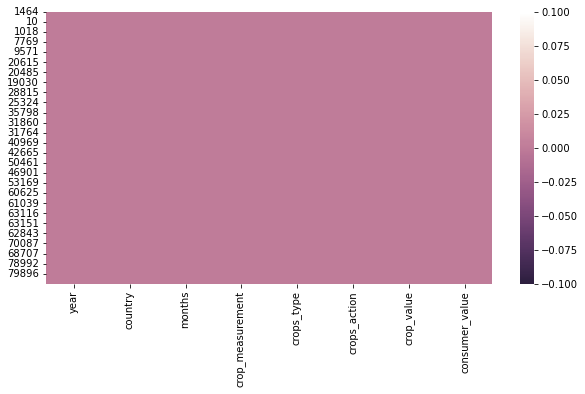

In [41]:
#Checking dataframe for missing data
%matplotlib inline
plt.figure(figsize=(10, 5))
colourmap = sns.cubehelix_palette(light=1, as_cmap=True, reverse=True)
sns.heatmap(df_brazildata.isnull(), cmap=colourmap)

# We can see we have no missing values or Nans within the dataset

In [42]:
import plotly.express as px
fig = px.box(df_brazildata, y='consumer_value')
fig.show()

<AxesSubplot:xlabel='crop_value'>

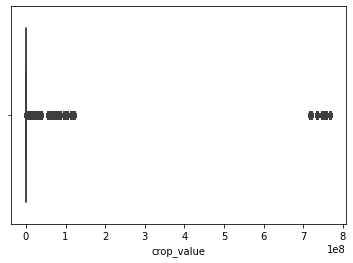

In [43]:
import seaborn as sns
#
# Box plot
#
sns.boxplot(df_brazildata.crop_value)

We can see from the above graph that the variable selling price is slightly right or postively skewed

<AxesSubplot:xlabel='consumer_value'>

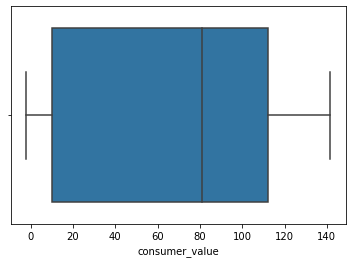

In [44]:
sns.boxplot(x=df_brazildata['consumer_value'])

This means that the data is partially skewed and that the extreme minimum is an outlier. whisker plot is slightly above and past the mean You may also notice that the extreme minimum is pretty far away from the box, and the box is located farther to the right. This means that the data is partially skewed and that the extreme minimum is an outlier.

But as this is prices I would not worry, however if this were 10 bathrooms when the norm is 2 maybe 3 I would be removing them as it would affect my results in the models later

<AxesSubplot:xlabel='crop_value', ylabel='Density'>

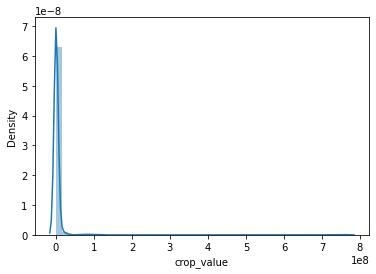

In [45]:
#
# Distribution plot
#
sns.distplot(df_brazildata.crop_value)

# We can see from the above graph that the variable cropvalue is slightly right or postively skewed

In [46]:
##check rows where dependent variable is equal to zero
df_brazildata.loc[df_brazildata['crop_value']==0]

,year,country,months,crop_measurement,crops_type,crops_action,crop_value,consumer_value
1464,2010,Brazil,January,tonnes,Chestnut,Production,0.0,3.559127
1471,2010,Brazil,August,tonnes,Chestnut,Production,0.0,4.098498
1465,2010,Brazil,February,tonnes,Chestnut,Production,0.0,4.271629
1470,2010,Brazil,July,tonnes,Chestnut,Production,0.0,4.338587
1469,2010,Brazil,June,tonnes,Chestnut,Production,0.0,5.074611
...,...,...,...,...,...,...,...,...
81346,2020,Brazil,November,ha,Ramie,Area harvested,0.0,139.230564
81382,2020,Brazil,November,tonnes,Ramie,Production,0.0,139.230564
77675,2020,Brazil,December,tonnes,Chestnut,Production,0.0,141.626625
81347,2020,Brazil,December,ha,Ramie,Area harvested,0.0,141.626625


# Target Variable Crop Value and Consumer Value I dont want any zeros in either for the regression

In [47]:
#We can see for the crop value column there are over 612 rows with the value 0 I we want to find the mean value of the column
print(df_brazildata['crop_value'].mean()) 

5333022.564655173


In [48]:
#For all rows with zero for the column crop_value replace them with the average value listed above and below.
df_brazildata['crop_value'] = df_brazildata['crop_value'].replace(0, 5333022.564655173) 

In [49]:
#We have 612 rows for the column crop_value that are null I am going to replace them too with the mean average value for that feature
# Replace NaNs in column crop_value with the
# mean of values in the same column
mean_value=df_brazildata['crop_value'].mean()
df_brazildata['crop_value'].fillna(value=mean_value, inplace=True)
print('Updated Dataframe:')
print(df_brazildata)

Updated Dataframe:
       year country     months crop_measurement  crops_type crops_action  \
1464   2010  Brazil    January           tonnes    Chestnut   Production   
1471   2010  Brazil     August           tonnes    Chestnut   Production   
1465   2010  Brazil   February           tonnes    Chestnut   Production   
1470   2010  Brazil       July           tonnes    Chestnut   Production   
1469   2010  Brazil       June           tonnes    Chestnut   Production   
...     ...     ...        ...              ...         ...          ...   
82423  2020  Brazil     August           tonnes  Sugar cane   Production   
82424  2020  Brazil  September           tonnes  Sugar cane   Production   
82425  2020  Brazil    October           tonnes  Sugar cane   Production   
82426  2020  Brazil   November           tonnes  Sugar cane   Production   
82427  2020  Brazil   December           tonnes  Sugar cane   Production   

         crop_value  consumer_value  
1464   5.333023e+06        3.5

In [50]:
##check rows where dependent variable is equal to zero
df_brazildata.loc[df_brazildata['consumer_value']==0]

,year,country,months,crop_measurement,crops_type,crops_action,crop_value,consumer_value


Consumer Value has no zero values to correct


In [51]:
# check the sum of null records again it should be 0 this time

df_brazildata.isnull().sum()

year                0
country             0
months              0
crop_measurement    0
crops_type          0
crops_action        0
crop_value          0
consumer_value      0
dtype: int64

In [52]:
##check cardinality

v_cardinality = df_brazildata.nunique()

print(v_cardinality)

year                  11
country                1
months                12
crop_measurement       9
crops_type            82
crops_action           7
crop_value          2200
consumer_value       395
dtype: int64


Text(0.5, 1.0, 'Cardinality')

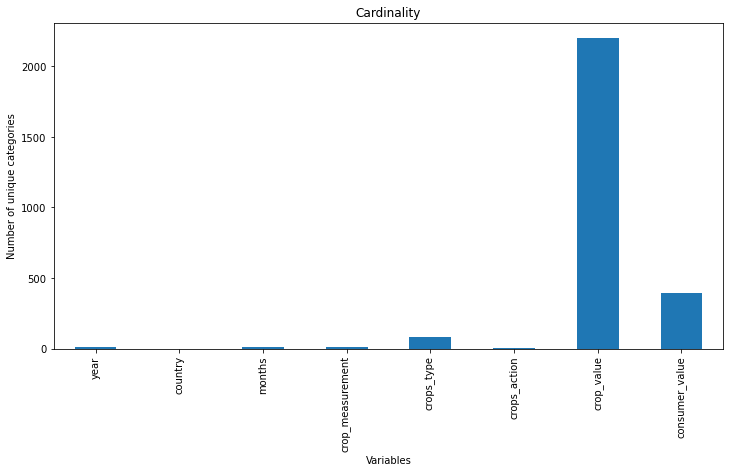

In [53]:
##plot cardinality using a barplot

df_brazildata.nunique().plot.bar(figsize=(12,6))

plt.ylabel('Number of unique categories')

plt.xlabel('Variables')

plt.title('Cardinality')

In [54]:
#checking the shape and size
print("Shape of the dataset is : ",df_brazildata.shape)
print("Size of the dataset is : ",df_brazildata.size)

Shape of the dataset is :  (83520, 8)
Size of the dataset is :  668160


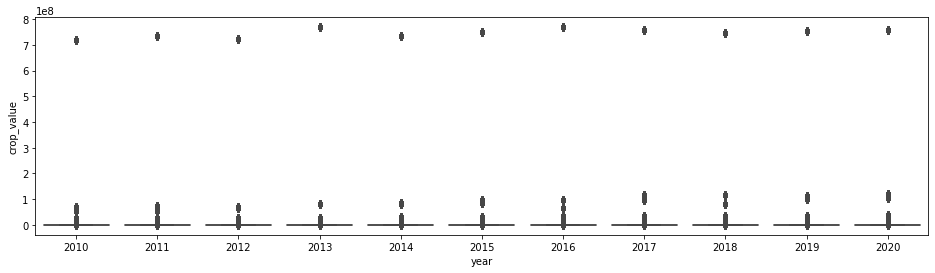

In [55]:
#Box plot visualisation to depict the crop price from 2010 to 2020
plt.figure(figsize = (16,4))
sns.boxplot(x='year', y='crop_value', data=df_brazildata)
plt.show()

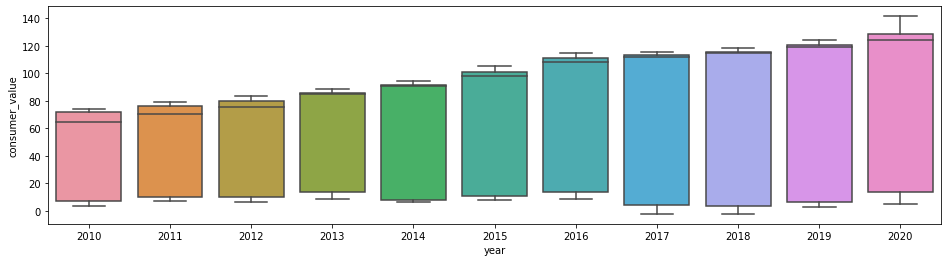

In [56]:
#Box plot visualisation to depict the consumer value from 2010 to 2020
plt.figure(figsize = (16,4))
sns.boxplot(x='year', y='consumer_value', data=df_brazildata)
plt.show()

In [57]:
import plotly.express as px

fig = px.bar(df_brazildata, x='year', y='crop_value',)

fig.show()

In [58]:
import plotly.express as px

fig = px.bar(df_brazildata, x='year', y='consumer_value',)
fig.show()

In [59]:
#create two arrays to compare coefficients
consumervalue=np.array(df_brazildata["consumer_value"])
cropvalue=np.array(df_brazildata["crop_value"])

In [60]:
#how to work out coefficients between consumer value and crop value
np.corrcoef (consumervalue, cropvalue)

array([[1.        , 0.00146176],
       [0.00146176, 1.        ]])

# The result tells us that there is a high correlation between consumer value and cropvalue

Below is a scatterplot to plot the results

In [61]:
import plotly.express as px

In [62]:
#Were creating two variables for our min and max values for the slider
xmin,xmax=min(df_brazildata["year"]), max(df_brazildata["year"])
ymin,ymax=min(df_brazildata["crop_value"]), max(df_brazildata["crop_value"])

In [63]:
#Using year as the animation frame, and as we go through each year the values will change want to group it by month
#The color will be the crops type each crop will have a different color, using hover for the year to give us info
#Split up the sections by usi by crops Action (yield, Harvest and Productions) 

fig= px.scatter(df_brazildata, x="year", y="crop_value", animation_frame ="year",
               animation_group="months",color="crops_type", hover_name="months", 
               facet_col="crops_action", width=1580, height=400, log_x=True, size_max=10000,
               range_x=[xmin,xmax],range_y=[ymin,ymax])

In [64]:
fig.show()

# Descriptive Statistics for the Target features: crop value & consumervalue

In [65]:
#inspect the dataframe for outliers will display the min,max mean and inner and outer quariles for all features
df_brazildata.describe()

,year,crop_value,consumer_value
count,83520.000000,8.352000e+04,83520.000000
mean,2014.975431,5.372101e+06,68.105087
std,3.151619,5.199071e+07,45.941999
min,2010.000000,9.000000e+00,-2.317125
25%,2012.000000,1.347600e+04,10.043639
50%,2015.000000,8.797600e+04,80.803340
75%,2018.000000,3.935035e+05,111.989600
max,2020.000000,7.685942e+08,141.626625


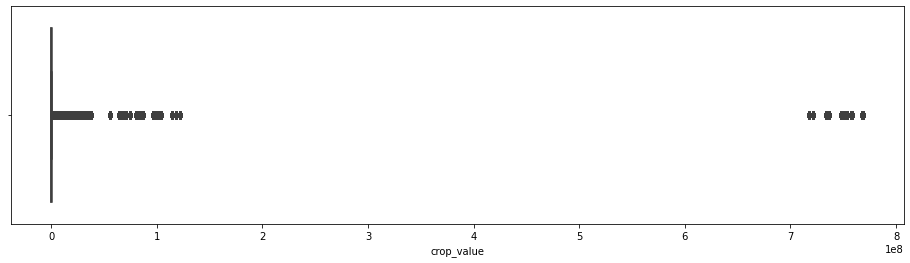

In [66]:
#boxplot for the target feature crop_value
plt.figure(figsize = (16,4))
sns.boxplot(x= df_brazildata['crop_value'])
plt.show()

In [67]:
#print the mean of the target feature
mean_cropvalue=  df_brazildata['crop_value'].mean()
print(mean_cropvalue)

5372100.747240936


In [68]:
#print the median of the target feature
median = df_brazildata['crop_value'].median()
print(median)

87976.0


In [69]:
#print the mode of the target feature
mode = df_brazildata['crop_value'].mode()
print(mode)

0    5.333023e+06
Name: crop_value, dtype: float64


[Text(0.5, 0, 'Crop Price'),
 Text(0, 0.5, 'Cropvalue'),
 Text(0.5, 1.0, 'Cropvalue Histogram')]

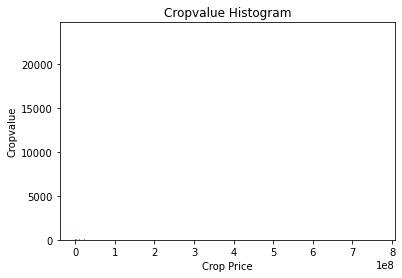

In [70]:
#histplot to display the distribution of crap _value
ax = sns.histplot(df_brazildata.crop_value)
ax.set(xlabel='Crop Price', ylabel='Cropvalue', title ='Cropvalue Histogram')

We can see from the above graph that the variable selling price is slightly right or postively skewed


Text(0.5, 1.0, 'Box plot Crop Value by Crop Action')

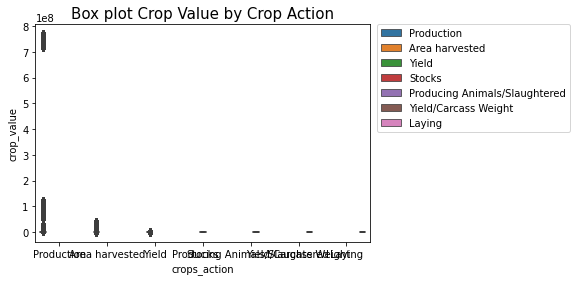

In [71]:
#Box plot to depict Box plot Crop Value by Crop Action
sns.boxplot(x = 'crops_action', y ='crop_value', data=df_brazildata, hue = 'crops_action')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title('Box plot Crop Value by Crop Action', fontsize=15)

In [72]:
# Dropping the rows of all rows under crops action that do not contain Yield only is what I am intersested in 
df_irishdata= df_brazildata[df_brazildata["crops_action"].str.contains("Production|Area harvested|Laying|Producing Animals/Slaughtered|Stocks") == False]
# display
df_brazildata

,year,country,months,crop_measurement,crops_type,crops_action,crop_value,consumer_value
1464,2010,Brazil,January,tonnes,Chestnut,Production,5.333023e+06,3.559127
1471,2010,Brazil,August,tonnes,Chestnut,Production,5.333023e+06,4.098498
1465,2010,Brazil,February,tonnes,Chestnut,Production,5.333023e+06,4.271629
1470,2010,Brazil,July,tonnes,Chestnut,Production,5.333023e+06,4.338587
1469,2010,Brazil,June,tonnes,Chestnut,Production,5.333023e+06,5.074611
...,...,...,...,...,...,...,...,...
82423,2020,Brazil,August,tonnes,Sugar cane,Production,7.571169e+08,130.229147
82424,2020,Brazil,September,tonnes,Sugar cane,Production,7.571169e+08,133.208033
82425,2020,Brazil,October,tonnes,Sugar cane,Production,7.571169e+08,135.798369
82426,2020,Brazil,November,tonnes,Sugar cane,Production,7.571169e+08,139.230564


[Text(0.5, 0, 'Crop Value'),
 Text(0, 0.5, 'Crop Price'),
 Text(0.5, 1.0, 'Crop Prices Histogram')]

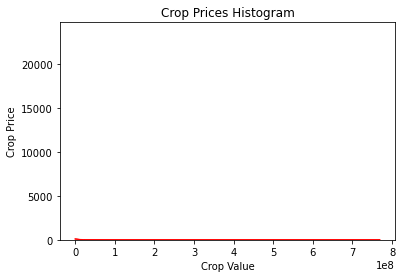

In [73]:
#histplot to display the distribution of crap _value in Red 
ax = sns.histplot( df_brazildata.crop_value, kde=True, color ='red')
ax.set(xlabel='Crop Value', ylabel='Crop Price', title ='Crop Prices Histogram')

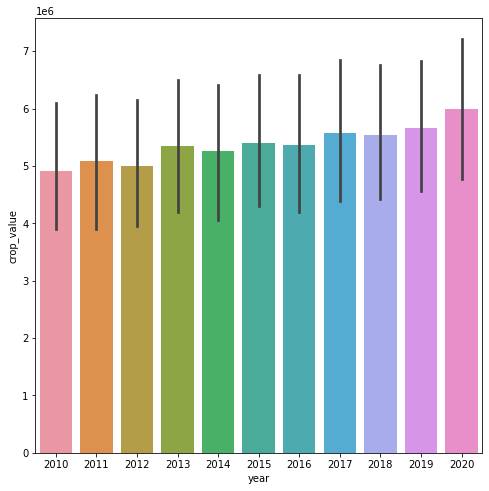

In [74]:
plt.figure(figsize=(8, 8))
ax = sns.barplot(x="year", y="crop_value", data=df_brazildata)

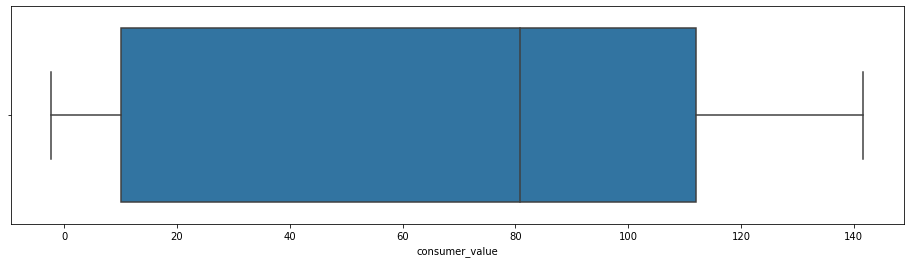

In [75]:
#boxplot for the feature rain
plt.figure(figsize = (16,4))
sns.boxplot(x= df_brazildata['consumer_value'])
plt.show()

In [76]:
#print the mean of the target feature
mean_consumervalue=  df_brazildata['consumer_value'].mean()
print(mean_consumervalue)

68.1050868260576


In [77]:
#print the median of the target feature
median = df_brazildata['consumer_value'].median()
print(median)

80.80334


In [78]:
#print the mode of the target feature
mode = df_brazildata['consumer_value'].mode()
print(mode)

0    72.17294
Name: consumer_value, dtype: float64


[Text(0.5, 0, 'Consumer Price'),
 Text(0, 0.5, 'consumervalue'),
 Text(0.5, 1.0, 'Consumervalue Histogram')]

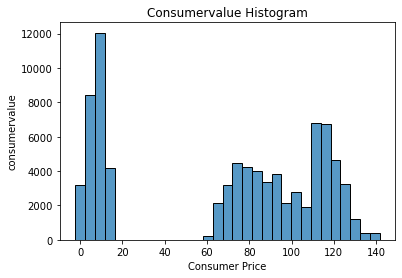

In [79]:
#histplot to display the distribution of consumer _value
ax = sns.histplot(df_brazildata.consumer_value)
ax.set(xlabel='Consumer Price', ylabel='consumervalue', title ='Consumervalue Histogram')

Text(0.5, 1.0, 'Box plot Consumer Value by Crop Action')

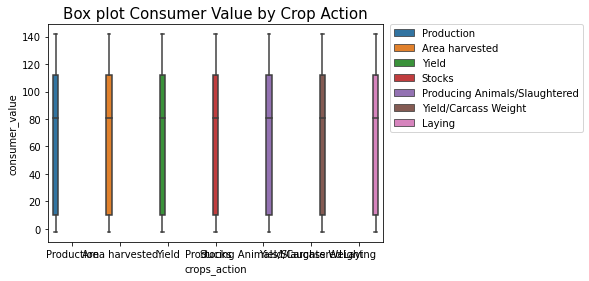

In [80]:
#Box plot to depict Box plot Crop Value by Crop Action
sns.boxplot(x = 'crops_action', y ='consumer_value', data=df_brazildata, hue = 'crops_action')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title('Box plot Consumer Value by Crop Action', fontsize=15)

In [81]:
#list the datatypes of all columns we can see there are alot of objects later I will change these to onehotencoding for the linear regression
df_brazildata.dtypes

year                  int64
country              object
months               object
crop_measurement     object
crops_type           object
crops_action         object
crop_value          float64
consumer_value      float64
dtype: object

# Shapiro-Wilk Test - Normality Test - Target crop_value

Tests whether a data sample has a Gaussian distribution. examines if a variable is normally distributed in a population

In [82]:
#Shapiro-Wilk Normality Test
from scipy.stats import shapiro
crop_value = [0.873, 2.817, 0.121, -0.945, -0.055, -1.436, 0.360, -1.478, -1.637, -1.869]
stat, p = shapiro(crop_value)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably Gaussian')
else:
	print('Probably not Gaussian')

stat=0.895, p=0.193
Probably Gaussian


Assumptions

Observations in each sample are independent and identically distributed (iid).

Interpretation

H0: the sample has a Gaussian distribution.

H1: the sample does not have a Gaussian distribution.

value of the Shapiro-Wilk Test is greater than 0.05, the data is normal. If it is below 0.05, the data significantly deviate from a normal distribution

# Shapiro-Wilk Test - Normality Test - Target Consumer_value

Tests whether a data sample has a Gaussian distribution. Examines if a variable is normally distributed in a population Crop Value Consumer Value Crops_action

In [83]:
#Shapiro-Wilk Normality Test
from scipy.stats import shapiro
consumer_value = [0.873, 2.817, 0.121, -0.945, -0.055, -1.436, 0.360, -1.478, -1.637, -1.869]
stat, p = shapiro(consumer_value)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably Gaussian')
else:
	print('Probably not Gaussian')

stat=0.895, p=0.193
Probably Gaussian


Assumptions

   Observations in each sample are independent and identically distributed (iid).

Interpretation

  H0: the sample has a Gaussian distribution. 
  
  H1: the sample does not have a Gaussian distribution.


In [84]:
# Example of the Shapiro-Wilk Normality Test
from scipy.stats import shapiro
crop_type = [0.873, 2.817, 0.121, -0.945, -0.055, -1.436, 0.360, -1.478, -1.637, -1.869]
stat, p = shapiro(crop_type)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably Gaussian')
else:
	print('Probably not Gaussian')

stat=0.895, p=0.193
Probably Gaussian


if the result is >0.05 the result is normal, the data significantly deviate from a normal distribution if <0.05

In [85]:
# import useful library
import numpy as np
from numpy.random import poisson
from numpy.random import seed
from scipy.stats import shapiro
from numpy.random import randn
  
seed(0)
# Create data
crops_action = poisson(5, 200)
  
# conduct the  Shapiro-Wilk Test
shapiro(crops_action)

ShapiroResult(statistic=0.966901957988739, pvalue=0.00011927181185455993)

Since in the above example, the p-value is 0.0001 which is less than the alpha(0.5) then we reject the null hypothesis i.e. we have sufficient evidence to say that sample does not come from a normal distribution

# Pearson’s Correlation Coefficient¶

Tests whether two samples have a linear relationship.

Crop_Value & Crop Action


Assumptions

    Observations in each sample are independent and identically distributed (iid).

    Observations in each sample are normally distributed.

    Observations in each sample have the same variance.


In [86]:
from scipy.stats import pearsonr
crop_value = [0.873, 2.817, 0.121, -0.945, -0.055, -1.436, 0.360, -1.478, -1.637, -1.869]
crop_action= [0.353, 3.517, 0.125, -7.545, -0.555, -1.536, 3.350, -1.578, -3.537, -1.579]
stat, p = pearsonr(crop_value, crop_action)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably independent')
else:
	print('Probably dependent')

stat=0.688, p=0.028
Probably dependent


Interpretation

H0: the two samples are independent.

H1: there is a dependency between the samples


# Pearson’s Correlation Coefficient

Tests whether two samples have a linear relationship.

Crop_Value & consumer_value


In [87]:
from scipy.stats import pearsonr
crop_value = [0.873, 2.817, 0.121, -0.945, -0.055, -1.436, 0.360, -1.478, -1.637, -1.869]
consumer_value= [0.353, 3.517, 0.125, -7.545, -0.555, -1.536, 3.350, -1.578, -3.537, -1.579]
stat, p = pearsonr(crop_value, consumer_value)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably independent')
else:
	print('Probably dependent')

stat=0.688, p=0.028
Probably dependent


Interpretation

H0: the two samples are independent.
    
H1: there is a dependency between the samples


# Spearman’s Rank Correlation

Tests whether two samples have a monotonic relationship.

Assumptions

 Observations in each sample are independent and identically distributed (iid).

 Observations in each sample can be ranked


In [88]:
from scipy.stats import spearmanr
crop_value = [0.873, 2.817, 0.121, -0.945, -0.055, -1.436, 0.360, -1.478, -1.637, -1.869]
crop_measurement = [0.353, 3.517, 0.125, -7.545, -0.555, -1.536, 3.350, -1.578, -3.537, -1.579]
stat, p = spearmanr(crop_value, crop_measurement)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably independent')
else:
	print('Probably dependent')

stat=0.855, p=0.002
Probably dependent


Interpretation

H0: the two samples are independent. 


H1: there is a dependency between the samples


# D’Agostino’s K^2 Test - Normality Test

Tests whether a data sample has a Gaussian distribution.


In [89]:
from scipy.stats import normaltest
crop_value = [0.873, 2.817, 0.121, -0.945, -0.055, -1.436, 0.360, -1.478, -1.637, -1.869]
stat, p = normaltest(crop_value)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably Gaussian')
else:
	print('Probably not Gaussian')

stat=3.392, p=0.183
Probably Gaussian


Assumptions

Observations in each sample are independent and identically distributed (iid).

Interpretation

H0: the sample has a Gaussian distribution. 
    
H1: the sample does not have a Gaussian distribution


# Using Chi-square test on a df_brazil dataset on the categorical features

In [90]:
import os
import pandas

df = pandas.read_csv("FAOSTAT_brazil_5-1-2022(4).csv")
categorical_col = ['Domain', 'Area', 'Item', 'Element','Unit']
print(categorical_col)

['Domain', 'Area', 'Item', 'Element', 'Unit']


using the crosstab() function to create a contingency table of the two selected variables to work on ‘crops_type’ and ‘crops_action’.

In [91]:
chisqt = pandas.crosstab(df.Domain, df.Element, margins=True)
print(chisqt)

Element                       Area harvested  Laying  Milk Animals  \
Domain                                                               
Crops and livestock products             781      22            22   
All                                      781      22            22   

Element                       Producing Animals/Slaughtered  Production  \
Domain                                                                    
Crops and livestock products                            231        1467   
All                                                     231        1467   

Element                       Stocks  Yield  Yield/Carcass Weight   All  
Domain                                                                   
Crops and livestock products     143    844                    99  3609  
All                              143    844                    99  3609  


we apply the chi2_contingency() function on the table and get the statistics, p-value and degree of freedom values

In [92]:
from scipy.stats import chi2_contingency 
import numpy as np
chisqt = pandas.crosstab(df.Domain, df.Element, margins=True)
value = np.array([chisqt.iloc[0][0:5].values,
                  chisqt.iloc[1][0:5].values])
print(chi2_contingency(value)[0:3])

(0.0, 1.0, 4)


From above, 1.0 is the p-value, 0.0 is the statistical value and 4 is the degree of freedom. As the p-value is greater than 0.05, we accept the NULL hypothesis and assume that the variables ‘Domain’ and ‘Element’ are independent of each other

In [93]:
df.head()

,Domain,Area,Element,Item,Year,Unit,Value
0,Crops and livestock products,Brazil,Area harvested,"Almonds, with shell",2010,ha,NaN
1,Crops and livestock products,Brazil,Area harvested,"Almonds, with shell",2011,ha,NaN
2,Crops and livestock products,Brazil,Area harvested,"Almonds, with shell",2012,ha,NaN
3,Crops and livestock products,Brazil,Area harvested,"Almonds, with shell",2013,ha,NaN
4,Crops and livestock products,Brazil,Area harvested,"Almonds, with shell",2014,ha,NaN


# Chi-Squared Test

Tests whether two categorical variables are related or independent.

Assumptions

Observations used in the calculation of the contingency table are independent.

25 or more examples in each cell of the contingency table.


In [94]:
# Example of the Chi-Squared Test
from scipy.stats import chi2_contingency
crop_value = [[10, 20, 30],[6,  9,  17]]
stat, p, dof, expected = chi2_contingency(crop_value)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably independent')
else:
	print('Probably dependent')

stat=0.272, p=0.873
Probably independent


# WE can see that the P - value for crop value is greater than 0.5 and is probably independant

Interpretation

H0: the two samples are independent.

H1: there is a dependency between the samples.


# Student’s t-test

Tests whether the means of two independent samples are significantly different.

Assumptions

Observations in each sample are independent and identically distributed (iid). 


Observations in each sample are normally distributed. 


Observations in each sample have the same variance.

In [95]:
# Example of the Student's t-test
from scipy.stats import ttest_ind
max_airtemp = [0.873, 2.817, 0.121, -0.945, -0.055, -1.436, 0.360, -1.478, -1.637, -1.869]
min_airtemp = [1.142, -0.432, -0.938, -0.729, -0.846, -0.157, 0.500, 1.183, -1.075, -0.169]
stat, p = ttest_ind(max_airtemp, min_airtemp)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably the same distribution')
else:
	print('Probably different distributions')

stat=-0.326, p=0.748
Probably the same distribution


Interpretation

H0: the means of the samples are equal.

H1: the means of the samples are unequal.


# Parametric Statistical Hypothesis Tests

This section lists statistical tests that you can use to compare data samples


# Paired Student’s t-test

Tests whether the means of two paired samples are significantly different.

Assumptions

     Observations in each sample are independent and identically distributed (iid). 

     Observations in each sample are normally distributed. 

     Observations in each sample have the same variance. Observations across each sample are paired.


In [96]:
# Example of the Student's t-test
from scipy.stats import ttest_ind
rain = [0.873, 2.817, 0.121, -0.945, -0.055, -1.436, 0.360, -1.478, -1.637, -1.869]
year = [1.142, -0.432, -0.938, -0.729, -0.846, -0.157, 0.500, 1.183, -1.075, -0.169]
stat, p = ttest_ind(rain, year)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably the same distribution')
else:
	print('Probably different distributions')

stat=-0.326, p=0.748
Probably the same distribution


interpretation

H0: the means of the samples are equal.

H1: the means of the samples are unequal.


In [97]:
df_brazildata.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 83520 entries, 1464 to 82427
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   year              83520 non-null  int64  
 1   country           83520 non-null  object 
 2   months            83520 non-null  object 
 3   crop_measurement  83520 non-null  object 
 4   crops_type        83520 non-null  object 
 5   crops_action      83520 non-null  object 
 6   crop_value        83520 non-null  float64
 7   consumer_value    83520 non-null  float64
dtypes: float64(2), int64(1), object(5)
memory usage: 5.7+ MB


# WE can see that the P value for Year is greater than 0.5 and is therefore of the same distribution

In [98]:
df_brazildata

,year,country,months,crop_measurement,crops_type,crops_action,crop_value,consumer_value
1464,2010,Brazil,January,tonnes,Chestnut,Production,5.333023e+06,3.559127
1471,2010,Brazil,August,tonnes,Chestnut,Production,5.333023e+06,4.098498
1465,2010,Brazil,February,tonnes,Chestnut,Production,5.333023e+06,4.271629
1470,2010,Brazil,July,tonnes,Chestnut,Production,5.333023e+06,4.338587
1469,2010,Brazil,June,tonnes,Chestnut,Production,5.333023e+06,5.074611
...,...,...,...,...,...,...,...,...
82423,2020,Brazil,August,tonnes,Sugar cane,Production,7.571169e+08,130.229147
82424,2020,Brazil,September,tonnes,Sugar cane,Production,7.571169e+08,133.208033
82425,2020,Brazil,October,tonnes,Sugar cane,Production,7.571169e+08,135.798369
82426,2020,Brazil,November,tonnes,Sugar cane,Production,7.571169e+08,139.230564


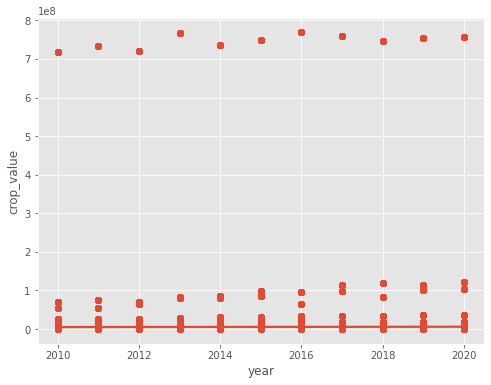

In [100]:
plt.style.use("ggplot")
plt.figure(figsize=(8,6))
sns.regplot(x=df_brazildata['year'], y = df_brazildata["crop_value"])
plt.show()

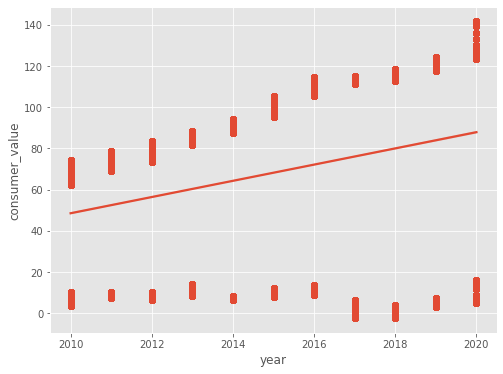

In [101]:
plt.style.use("ggplot")
plt.figure(figsize=(8,6))
sns.regplot(x = df_brazildata["year"], y = df_brazildata["consumer_value"])
plt.show()

# Exploratory Data Analysis

Let's take a look at the pearson correlation coefficients. This helps us understand the extent to which two variables are correlated. We will be able to see both the strength of the correlation as well as the direction and use that to make a decision on the exclusion of predictive variables that display multicollinearity.

In [102]:
# create correlation matrix displaying pearson correlation coefficients for all variables
corr_matrix = df_brazildata.corr()
corr_matrix

,year,crop_value,consumer_value
year,1.00000,0.005400,0.269980
crop_value,0.00540,1.000000,0.001462
consumer_value,0.26998,0.001462,1.000000


We can also visually examine the relationships between the measurable variables via a scatterplot using a randomly selected sample size of 1,000. We also see the histograms for each of the measurable variables displayed across the diagonal

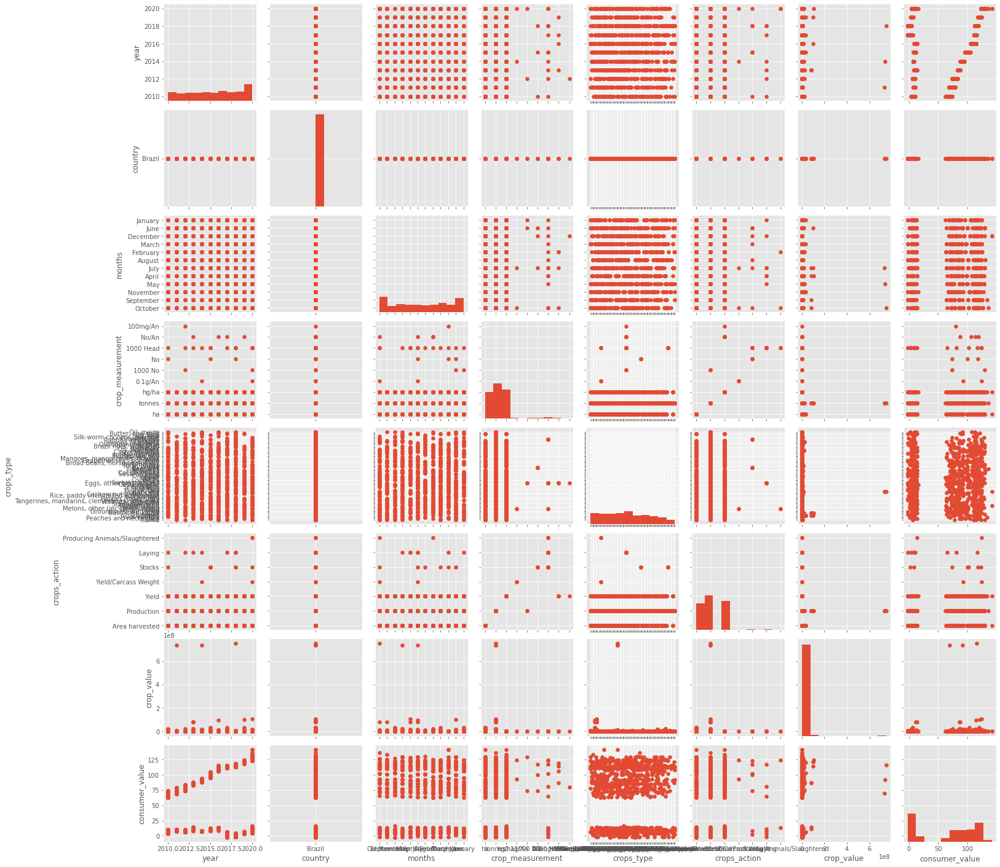

In [103]:
# plot pair grid with histograms and scatterplots using seaborn pairgrid
irish_data_sample =  df_brazildata.sample(1000)
p = sns.PairGrid(data=irish_data_sample, vars=["year","country","months","crop_measurement","crops_type","crops_action","crop_value","consumer_value"])
p.map_diag(plt.hist)
p.map_offdiag(plt.scatter)

We can observe a roughly normal distribution for available_bike_stands. A decision will need to be made as to which should be used when we create the linear regression model. crops_type will be the Target variable


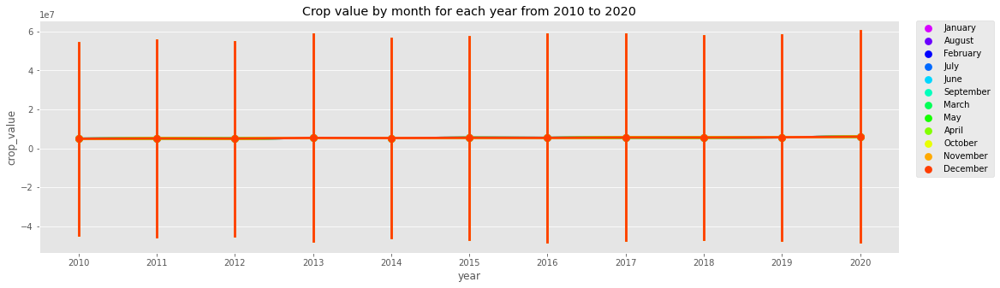

In [104]:
# create point plot using seaborn pointplot to display Crop Value by month for each year from 2010 to 2020
fig,(ax1)= plt.subplots(nrows=1)
fig.set_size_inches(18,5)
sns.pointplot(data= df_brazildata, x='year', y='crop_value', ci="sd", hue='months', palette='gist_rainbow_r')
ax1.set(title='Crop value by month for each year from 2010 to 2020')
#place legend outside top right corner of plot
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

[Text(0.5, 1.0, 'Count of the type of crops and value for each year from 2010 to 2020')]

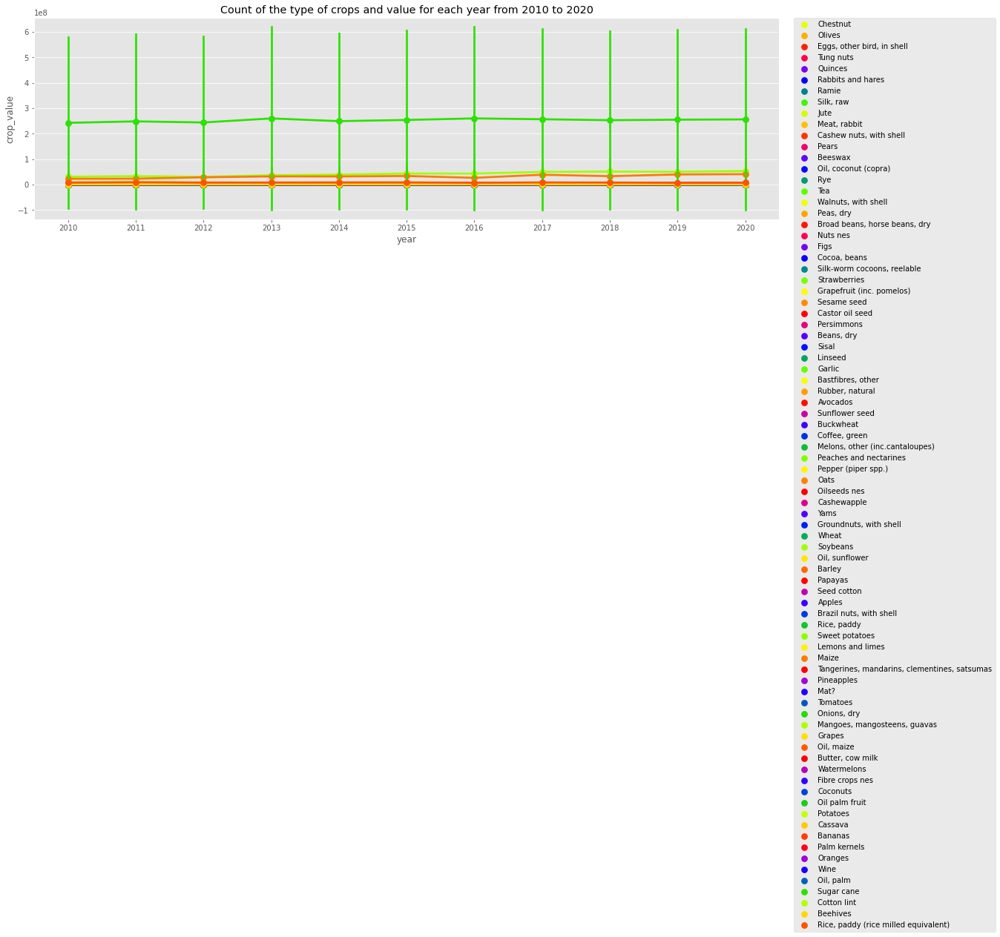

In [105]:
# create point plot Count of the type of crops and value for each year from 2010 to 2020 using seaborn pointplot
fig,(ax1)= plt.subplots(nrows=1)
fig.set_size_inches(18,5)
sns.pointplot(data= df_brazildata, x='year', y='crop_value', ci="sd", hue='crops_type', palette='prism_r')
#place legend outside top right corner of plot
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
ax1.set(title='Count of the type of crops and value for each year from 2010 to 2020')

[Text(0.5, 1.0, 'Crop value by crop action for each year over the decade')]

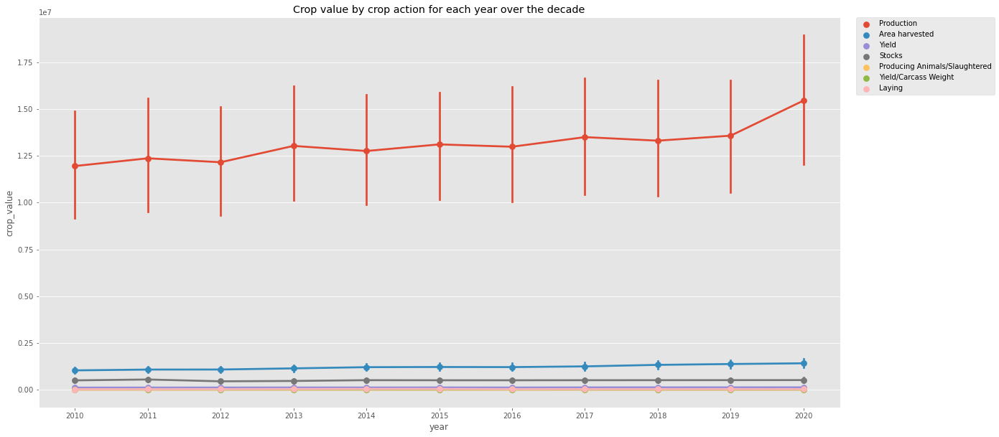

In [106]:
#Crop value by crop action for each year over the decade using seaborn pointplot

fig, ax = plt.subplots(figsize=(20,10))
sns.pointplot(data=df_brazildata, x='year', y='crop_value', hue='crops_action', ax=ax)
#place legend outside top right corner of plot
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
ax.set(title='Crop value by crop action for each year over the decade')

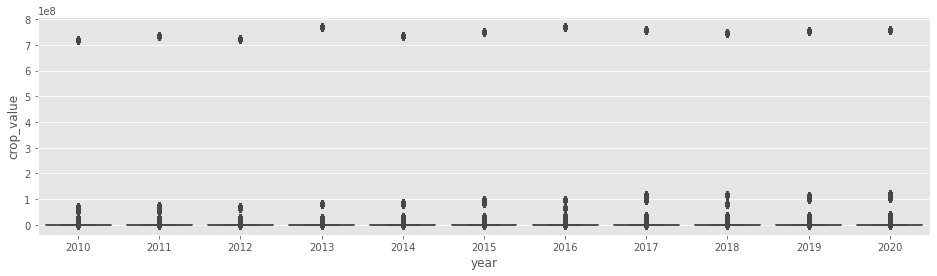

In [107]:
#Box plot visualisation to depict the crop price from 2010 to 2020
plt.figure(figsize = (16,4))
sns.boxplot(x='year', y='crop_value',data=df_brazildata)
plt.show()

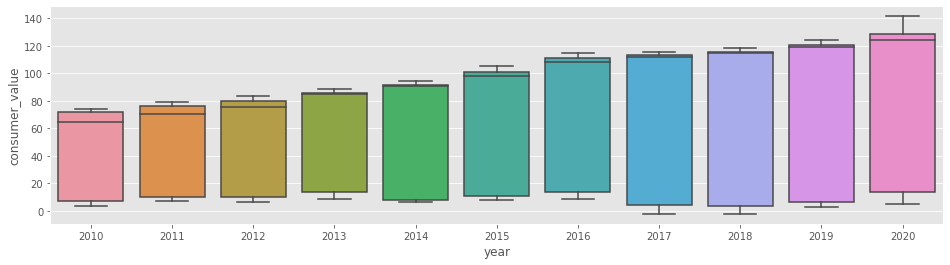

In [108]:
#Box plot visualisation to depict the rain for each year
plt.figure(figsize = (16,4))
sns.boxplot(x='year', y='consumer_value',data=df_brazildata)
plt.show()

<AxesSubplot:xlabel='months', ylabel='consumer_value'>

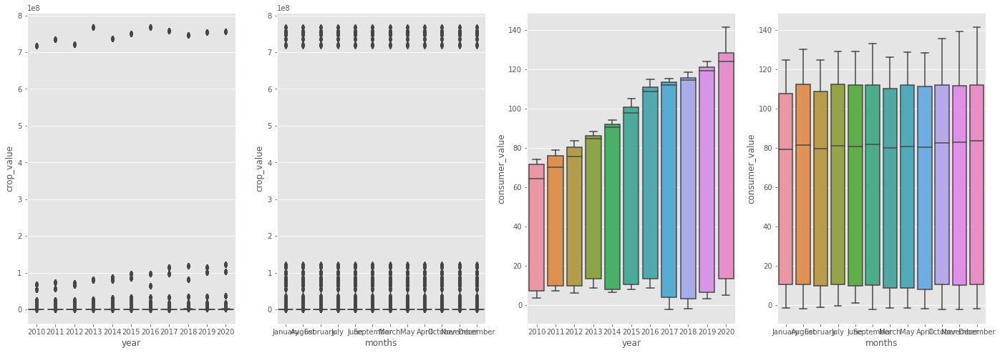

In [109]:
# create box plots for time related variables using seaborn boxplot
figure, (ax1, ax2, ax3, ax4) = plt.subplots(nrows=1, ncols=4)
figure.set_size_inches(24, 8)

sns.boxplot(data=df_brazildata, x='year', y='crop_value', ax=ax1)
sns.boxplot(data=df_brazildata, x='months', y='crop_value', ax=ax2)
sns.boxplot(data=df_brazildata, x='year', y='consumer_value', ax=ax3)
sns.boxplot(data=df_brazildata, x='months', y='consumer_value', ax=ax4)

[Text(0.5, 1.0, 'Theoritical quantiles')]

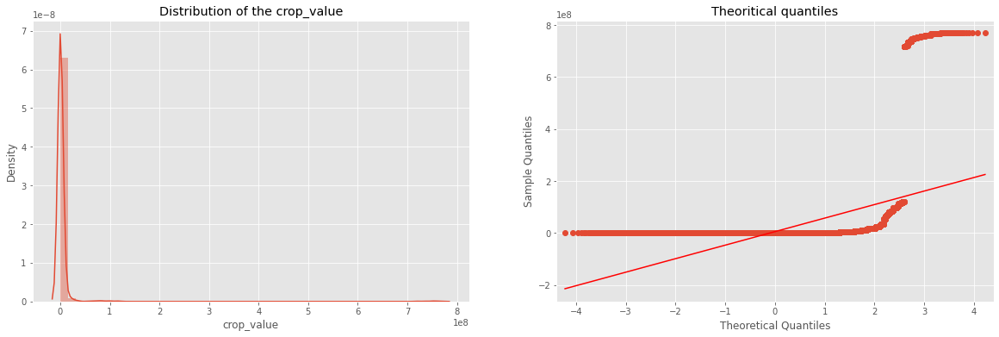

In [110]:
# seaborn distplot used to depict the distribution of cropvalue and the Theoritical quantiles of that feature
from statsmodels.graphics.gofplots import qqplot
fig, (ax1,ax2) = plt.subplots(ncols=2, figsize=(20,6))
sns.distplot(df_brazildata['crop_value'], ax=ax1)
ax1.set(title='Distribution of the crop_value')
qqplot(df_brazildata['crop_value'], ax=ax2, line='s')
ax2.set(title='Theoritical quantiles')

[Text(0.5, 1.0, 'Theoritical quantiles')]

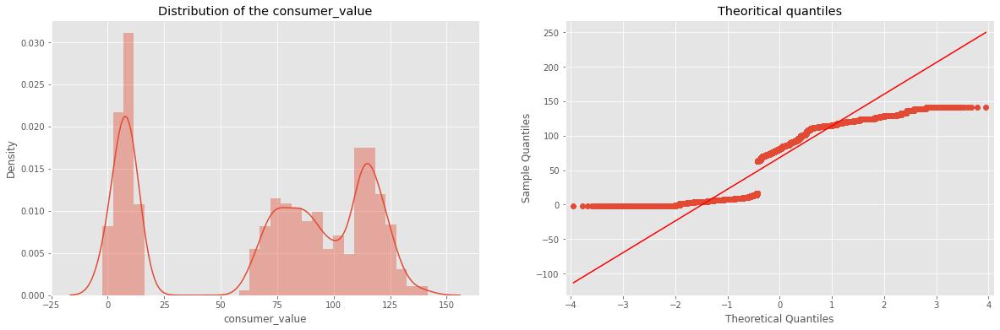

In [111]:
# seaborn distplot used to depict the distribution of max_airtemp and the Theoritical quantiles of grass_minimumtemp
from statsmodels.graphics.gofplots import qqplot
fig, (ax1,ax2) = plt.subplots(ncols=2, figsize=(20,6))
sns.distplot(df_brazildata['consumer_value'], ax=ax1)
ax1.set(title='Distribution of the consumer_value')
qqplot(df_irishdata['consumer_value'], ax=ax2, line='s')
ax2.set(title='Theoritical quantiles')

<AxesSubplot:>

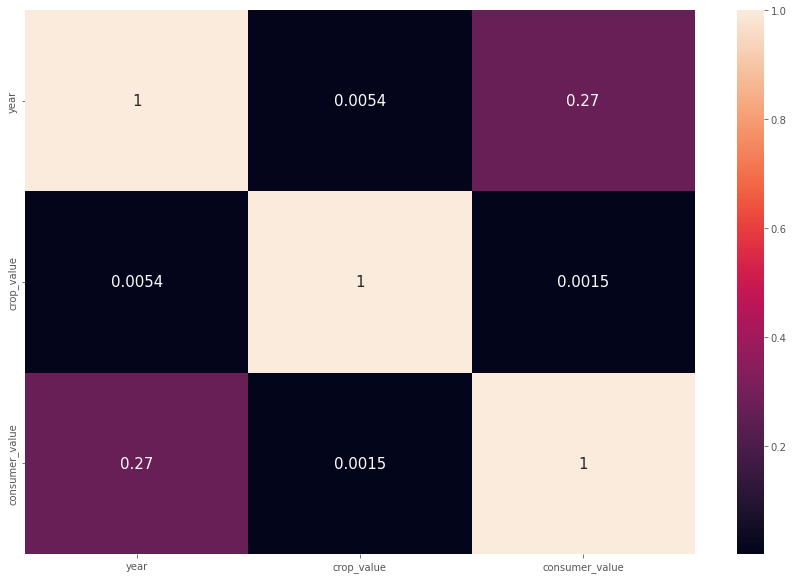

In [112]:
#Coorelation Matrix to compare the relationships and correlation between features
corr = df_brazildata.corr()
plt.figure(figsize=(15,10))
sns.heatmap(corr, annot=True, annot_kws={'size':15})

-1 indicates a perfectly negative linear correlation between two variables. 0 indicates no linear correlation between two variables. 1 indicates a perfectly positive linear correlation between two variables

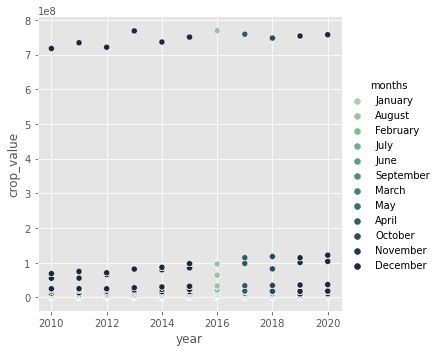

In [113]:
#using a seaborn relplot to plot 3 data points to see the relationship between 2 variables using my own color pallete hue is hour time of day
sns.relplot(x="year", y="crop_value", hue="months", palette="ch:r=-.5,l=.75", data=df_brazildata);

In [114]:
#Using plotly to display barchart Value of crops produced by Ireland each year crops type action and month displayed
import plotly.express as px

fig = px.bar(df_brazildata, x='year', y='crop_value',
                hover_data=['crops_type','months'], color='crops_action',
                labels={'country':'Value of crops produced by Ireland each year'}, height=400, title='Value of crops produced by Ireland each year')

fig.show()

# Below the Csv after been explored and cleaned has now been saved so as I can just read this in for my models going forward

In [115]:
#now that the data has been explored and cleaned saving it to be used for the model
df_brazildata.to_csv('df_brazilmodels.csv')

# Read in df_brazilmodels.csv into the df_brazildata frame for linear model

In [116]:
#Reading in Irish Crops dataset from between 2010 to 2020 8 actions 10 crop measurements and 139 crop types
df_brazildata = pd.read_csv('df_brazilmodels.csv')
df_brazildata.head()

,Unnamed: 0,year,country,months,crop_measurement,crops_type,crops_action,crop_value,consumer_value
0,1464,2010,Brazil,January,tonnes,Chestnut,Production,5.333023e+06,3.559127
1,1471,2010,Brazil,August,tonnes,Chestnut,Production,5.333023e+06,4.098498
2,1465,2010,Brazil,February,tonnes,Chestnut,Production,5.333023e+06,4.271629
3,1470,2010,Brazil,July,tonnes,Chestnut,Production,5.333023e+06,4.338587
4,1469,2010,Brazil,June,tonnes,Chestnut,Production,5.333023e+06,5.074611


In [152]:
# create binary dummy variables from categorical variables and drop first column to avoid multicollinearity
df_brazildata = pd.get_dummies(df_brazildata, columns = ['crops_action','crops_type','months','crop_measurement'],drop_first = True)

In [167]:
# inspect bike_data df with added dummy variables
df_brazildata.head(5)

,year,months,crop_measurement,crops_type,crops_action,crop_value,consumer_value
0,2010,January,tonnes,Chestnut,Production,5.333023e+06,3.559127
1,2010,August,tonnes,Chestnut,Production,5.333023e+06,4.098498
2,2010,February,tonnes,Chestnut,Production,5.333023e+06,4.271629
3,2010,July,tonnes,Chestnut,Production,5.333023e+06,4.338587
4,2010,June,tonnes,Chestnut,Production,5.333023e+06,5.074611


In [168]:
#Reading in Irish Crops dataset from between 2010 to 2020 8 actions 10 crop measurements and 139 crop types
df_brazildata = pd.read_csv('df_brazilmodels.csv')
df_brazildata.head()

,Unnamed: 0,year,country,months,crop_measurement,crops_type,crops_action,crop_value,consumer_value
0,1464,2010,Brazil,January,tonnes,Chestnut,Production,5.333023e+06,3.559127
1,1471,2010,Brazil,August,tonnes,Chestnut,Production,5.333023e+06,4.098498
2,1465,2010,Brazil,February,tonnes,Chestnut,Production,5.333023e+06,4.271629
3,1470,2010,Brazil,July,tonnes,Chestnut,Production,5.333023e+06,4.338587
4,1469,2010,Brazil,June,tonnes,Chestnut,Production,5.333023e+06,5.074611


In [169]:
#Dropping ID and Source column from the data for outlier analysis
df_brazildata.drop(columns=["Unnamed: 0","country"],axis=1,inplace=True)
df_brazildata.dtypes

year                  int64
months               object
crop_measurement     object
crops_type           object
crops_action         object
crop_value          float64
consumer_value      float64
dtype: object

In [170]:

# create binary dummy variables from categorical variables and drop first column to avoid multicollinearity
df_brazildata = pd.get_dummies(df_brazildata, columns = ['crops_action','crops_type','months','crop_measurement'],drop_first = True)

In [171]:
# check all columns for Nans
df_brazildata.isna().any()

year                                          False
crop_value                                    False
consumer_value                                False
crops_action_Laying                           False
crops_action_Producing Animals/Slaughtered    False
                                              ...  
crop_measurement_No                           False
crop_measurement_No/An                        False
crop_measurement_ha                           False
crop_measurement_hg/ha                        False
crop_measurement_tonnes                       False
Length: 109, dtype: bool

# Creating the Multiple Regression and Evaluating the Model

 To start we will create a multiple regression using all of the independant features to get a baseline.

In [172]:
# set the target variable
y = df_brazildata['crop_value']

# set the independent predictor variables
X = df_brazildata.drop('crop_value', axis=1)

# split data into training and test sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)# 70% training and 30% test
X_train = sm.add_constant(X_train)
print("Training split input- ", X_train.shape)
print("Testing split input- ", X_test.shape)
X_train.head()

Training split input-  (58464, 109)
Testing split input-  (25056, 108)


,const,year,consumer_value,crops_action_Laying,crops_action_Producing Animals/Slaughtered,crops_action_Production,crops_action_Stocks,crops_action_Yield,crops_action_Yield/Carcass Weight,crops_type_Avocados,...,months_October,months_September,crop_measurement_1000 Head,crop_measurement_1000 No,crop_measurement_100mg/An,crop_measurement_No,crop_measurement_No/An,crop_measurement_ha,crop_measurement_hg/ha,crop_measurement_tonnes
63501,1.0,2018,118.163100,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
4777,1.0,2010,71.086900,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,1,0
63723,1.0,2018,-1.454346,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
40124,1.0,2015,99.222310,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,1,0
37865,1.0,2014,92.243620,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,0


# Model 1 Linear Regression using all independant variables/features

In [173]:
# fit data to linear regression
mlr1 = sm.OLS(y_train, X_train).fit()

# view OLS regression results
print(mlr1.summary())

                            OLS Regression Results                            
Dep. Variable:             crop_value   R-squared:                       0.352
Model:                            OLS   Adj. R-squared:                  0.350
Method:                 Least Squares   F-statistic:                     310.2
Date:                Tue, 20 Dec 2022   Prob (F-statistic):               0.00
Time:                        20:49:47   Log-Likelihood:            -1.1090e+06
No. Observations:               58464   AIC:                         2.218e+06
Df Residuals:                   58361   BIC:                         2.219e+06
Df Model:                         102                                         
Covariance Type:            nonrobust                                         
                                                              coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------

R-squared: 0.352 Model: OLS Adj. R-squared: 0.350

# Model 1 - Linear Regression (Dropping consumer_value well over 0.5

In [174]:
#Dropping all of the features below with a high p-value from the training model
X_train2 = X_train.drop(['consumer_value'], axis=1)
mlr2 = sm.OLS(y_train, X_train2).fit()
print(mlr2.summary())

                            OLS Regression Results                            
Dep. Variable:             crop_value   R-squared:                       0.352
Model:                            OLS   Adj. R-squared:                  0.350
Method:                 Least Squares   F-statistic:                     313.3
Date:                Tue, 20 Dec 2022   Prob (F-statistic):               0.00
Time:                        20:49:59   Log-Likelihood:            -1.1090e+06
No. Observations:               58464   AIC:                         2.218e+06
Df Residuals:                   58362   BIC:                         2.219e+06
Df Model:                         101                                         
Covariance Type:            nonrobust                                         
                                                              coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------

Dep. Variable: crop_value R-squared: 0.352 Model: OLS Adj. R-squared: 0.350 NO improvement after dropping consumer_value some of the crops have a very high P- Value I will drop some of those to see if there is improvement

# Model 1 - Linear Regression (Dropping all of the hour columns) backward selection

In [175]:
#Dropping all of the Temperature features with a high p-value from the training model
X_train3 = X_train2.drop(['crops_type_Avocados','crops_type_Barley','crops_type_Bastfibres, other','crops_type_Broad beans, horse beans, dry'], axis=1)
mlr3 = sm.OLS(y_train, X_train3).fit()
print(mlr3.summary())

                            OLS Regression Results                            
Dep. Variable:             crop_value   R-squared:                       0.352
Model:                            OLS   Adj. R-squared:                  0.351
Method:                 Least Squares   F-statistic:                     326.3
Date:                Tue, 20 Dec 2022   Prob (F-statistic):               0.00
Time:                        20:50:06   Log-Likelihood:            -1.1090e+06
No. Observations:               58464   AIC:                         2.218e+06
Df Residuals:                   58366   BIC:                         2.219e+06
Df Model:                          97                                         
Covariance Type:            nonrobust                                         
                                                              coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------

                        OLS Regression Results                            

============================================================================== Dep. Variable: crop_value R-squared: 0.352 Model: OLS Adj. R-squared: 0.351 adj Rsquared slightly improved

    Going to drop further crop types

# Model 4 - Linear Regression (Dropping all of the cluster group columns as the p value is above 0.5) backward selection

In [176]:
#Dropping all of the categorial dummie Crop values  Group features with a high p-value from the training model
X_train4 = X_train3.drop(['crops_type_Buckwheat','crops_type_Cashew nuts, with shell','crops_type_Cashewapple','crops_type_Castor oil seed','crops_type_Cocoa, beans','crops_type_Garlic','crops_type_Grapefruit (inc. pomelos)','crops_type_Jute','crops_type_Nuts nes'], axis=1)
mlr4 = sm.OLS(y_train, X_train4).fit()
print(mlr4.summary())

                            OLS Regression Results                            
Dep. Variable:             crop_value   R-squared:                       0.352
Model:                            OLS   Adj. R-squared:                  0.351
Method:                 Least Squares   F-statistic:                     359.7
Date:                Tue, 20 Dec 2022   Prob (F-statistic):               0.00
Time:                        20:50:19   Log-Likelihood:            -1.1090e+06
No. Observations:               58464   AIC:                         2.218e+06
Df Residuals:                   58375   BIC:                         2.219e+06
Df Model:                          88                                         
Covariance Type:            nonrobust                                         
                                                              coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------

                        OLS Regression Results                            
Dep. Variable: crop_value R-squared: 0.352 Model: OLS Adj. R-squared: 0.351

After looking at the results from model 4 I will keep this as our final model as all pvalues are under 0.5 infact almost at 0


# Variance Inflation Factors (VIF)

Variance inflation factors range from a value of 1.0 and upwards. The VIF helps us quantify the severity of multicollinearity in an OLS regression. The VIF value tells us how much larger the standard error increases compared to if that variable had 0 correlation to other independent predictor variables in your model.

In [177]:
# create dataframe to calculate and display VIF for each variable
vif = pd.DataFrame()
vif['Features'] = X_train4.columns
vif['VIF'] = [variance_inflation_factor(X_train.values, i) for i in range(X_train4.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
14,crops_type_Cassava,inf
65,crops_type_Sunflower seed,inf
3,crops_action_Producing Animals/Slaughtered,inf
4,crops_action_Production,inf
5,crops_action_Stocks,inf
...,...,...
55,"crops_type_Rubber, natural",1.30
48,crops_type_Pineapples,1.30
1,year,1.08
2,crops_action_Laying,1.08


Looking at the results above and interpreting them 1 = not correlated. Between 1 and 5 = moderately correlated. Greater than 5 = highly correlated. We can see 55,48,1 and 2 are NOT correlated and the top ones have a value of inf infinitity excellent perfect correlation this is for some of the crops and crop actions such as yield this would make sense.

# Making Predictions With Final Model

We are going to create our final model for prediction using the final set of variables that we had in our final training model.

In [183]:
# drop predictive variables to prepare final model
X_test = sm.add_constant(X_test)
X_test_1 = X_test[X_train4.columns] 

# fit data to linear regression for final model using test data
mlr_test = sm.OLS(y_test, X_test_1).fit()

# inspect X_test data
X_test_1.head()

,const,year,crops_action_Laying,crops_action_Producing Animals/Slaughtered,crops_action_Production,crops_action_Stocks,crops_action_Yield,crops_action_Yield/Carcass Weight,crops_type_Bananas,"crops_type_Beans, dry",...,months_October,months_September,crop_measurement_1000 Head,crop_measurement_1000 No,crop_measurement_100mg/An,crop_measurement_No,crop_measurement_No/An,crop_measurement_ha,crop_measurement_hg/ha,crop_measurement_tonnes
67851,1.0,2018,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
62961,1.0,2018,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,1,0
61777,1.0,2018,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
77471,1.0,2020,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,1,0
15593,1.0,2012,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


Now we will make predictions of the y variable which is crops_value using our final test model

In [184]:
# Making predictions using the final model
y_pred = mlr_test.predict(X_test_1)

# Evaluating Predictions of Final Model

To evaluate our final model we will look a number of data points and visualizations. First we start off with a distribution plot of predicted y values subtracted from the actual y values from the test dataset. This will help us visualize the distribution of errors. We also take a look at a scatter plot of predicted y values vs actuals from the test data set.

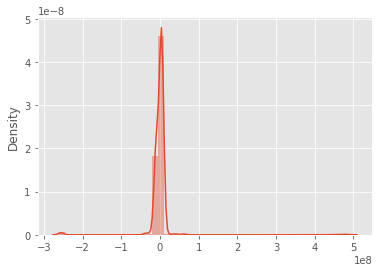

In [181]:
# distribution plot of predicted y values vs test y values
sns.distplot((y_test - y_pred), bins=50);

Text(0, 0.5, 'y_pred')

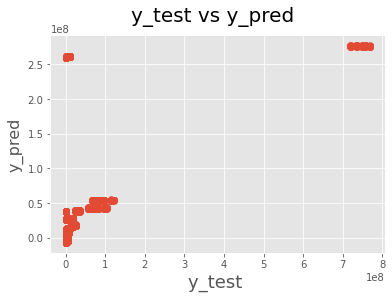

In [182]:
# Plotting y_test and y_pred to understand the spread.
fig = plt.figure()
plt.scatter(y_test,y_pred)
fig.suptitle('y_test vs y_pred', fontsize=20)   
plt.xlabel('y_test ', fontsize=18)                       
plt.ylabel('y_pred', fontsize=16) 

We can see from the graph above observing the spread for y_pred and Y_test there is a couple of outliers but for the majority we can say that there is infact a moderate linear correlation. The RMSE is the standard deviation of the prediction errors also known as residuals. This helps us understand how well the actual data fits our model.

Now we will make predictions of the y variable which is crops_value using our final test model

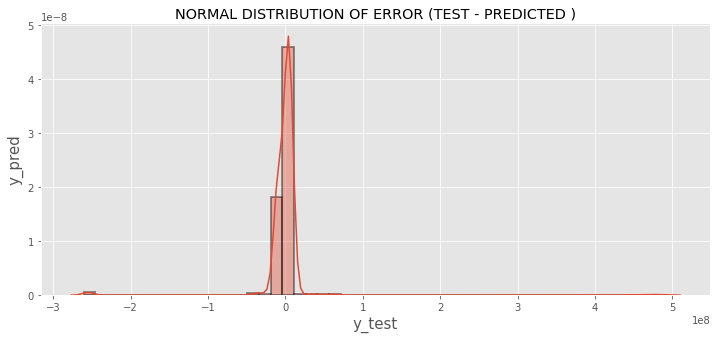

In [185]:
## * NORMAL DISTRIBUTION OF ERROR (TEST - PREDICTED ) *

plt.figure(figsize=(12,5))
sns.distplot((y_test-y_pred),bins=50,hist_kws=dict(edgecolor="k", linewidth=2));
plt.xlabel('y_test', fontsize='15')
plt.ylabel('y_pred', fontsize='15')
plt.title("NORMAL DISTRIBUTION OF ERROR (TEST - PREDICTED )")
plt.savefig("lr1")

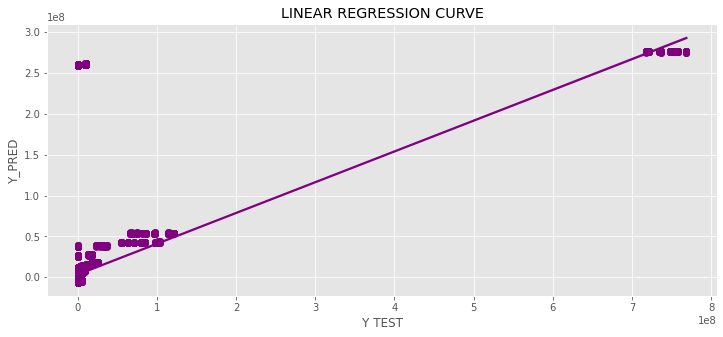

In [186]:
### LINEAR REGRESSION CURVE

plt.figure(figsize=(12,5))
sns.regplot(y_test,y_pred, df_brazildata,color='purple')
plt.xlabel("Y TEST")
plt.ylabel("Y_PRED")
plt.title("LINEAR REGRESSION CURVE")
plt.savefig("lr3")

In [187]:
# create R2 score
r2 = r2_score(y_test, y_pred)

# create Adjusted R2 Score
p = len(X_test_1.columns)
n = y_test.shape[0]
adj_r2 = 1 - (1 - r2) * ((n - 1)/(n-p-1))

# create RMSE score
rmse = mean_squared_error(y_test, y_pred, squared = False)


# print final model performance stats
print(str(p) + " Predictors in Test Set")
print(str(n) + " Records in Test Set")
print("R2: " + str(r2))
print("Adj R2: " + str(adj_r2))
print("RMSE: " + str(rmse))

95 Predictors in Test Set
25056 Records in Test Set
R2: 0.37672347857732547
Adj R2: 0.3743512322017184
RMSE: 41045956.165925846


Let's compare the R2 and Adj R2 values from the training dataset vs the test dataset.

Test Dataset R2: 0.37672347857732547 Adj R2: 0.3743512322017184


# Final Linear Model Conclusion

In [188]:
from sklearn.metrics import mean_squared_error, mean_absolute_error

print('Mean Absolute Error:', mean_absolute_error(y_test, y_pred))  
print('Mean Squared Error:', mean_squared_error(y_test, y_pred))  
print('Root Mean Squared Error:', np.sqrt(mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 10579146.240595227
Mean Squared Error: 1684770517575106.0
Root Mean Squared Error: 41045956.165925846


MAE: A metric that tells us the mean absolute difference between the predicted values and the actual values in a dataset. The lower the MAE, the better a model fits a dataset

The lower the MSE the higher the accuracy of prediction as there would be excellent match between the actual and predicted data set

RMSE: A metric that tells us the square root of the average squared difference between the predicted values and the actual values in a dataset. The lower the RMSE, the better a model fits a dataset


In [189]:
#print the R2_Score
from sklearn.metrics import r2_score
r2_score(y_test, y_pred)

0.37672347857732547

# Multiple Linear Regression Not using Stats Models

In [193]:
#Reading in Irish Crops dataset from between 2010 to 2020 8 actions 10 crop measurements and 139 crop types
df_brazildata = pd.read_csv('df_brazilmodels.csv')
df_brazildata.head()

,Unnamed: 0,year,country,months,crop_measurement,crops_type,crops_action,crop_value,consumer_value
0,1464,2010,Brazil,January,tonnes,Chestnut,Production,5.333023e+06,3.559127
1,1471,2010,Brazil,August,tonnes,Chestnut,Production,5.333023e+06,4.098498
2,1465,2010,Brazil,February,tonnes,Chestnut,Production,5.333023e+06,4.271629
3,1470,2010,Brazil,July,tonnes,Chestnut,Production,5.333023e+06,4.338587
4,1469,2010,Brazil,June,tonnes,Chestnut,Production,5.333023e+06,5.074611


In [194]:
#Dropping ID and Source column from the data for outlier analysis
df_brazildata.drop(columns=["Unnamed: 0","country"],axis=1,inplace=True)
df_brazildata.dtypes

year                  int64
months               object
crop_measurement     object
crops_type           object
crops_action         object
crop_value          float64
consumer_value      float64
dtype: object

In [196]:
#binary dummy variables from categorical variables and drop first column to avoid multicollinearity
df_brazildata = pd.get_dummies(df_brazildata, columns = ['crops_action','crops_type','months','crop_measurement'],drop_first = True)

In [197]:
# set the target variable
y = df_brazildata['crop_value']

# set the independent predictor variables
X = df_brazildata.drop('crop_value', axis=1)

In [198]:
# Splitting the dataset into the Training set and Test set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 0)

print("Training split input- ", X_train.shape)
print("Testing split input- ", X_test.shape)
X_train.head()

Training split input-  (58464, 108)
Testing split input-  (25056, 108)


,year,consumer_value,crops_action_Laying,crops_action_Producing Animals/Slaughtered,crops_action_Production,crops_action_Stocks,crops_action_Yield,crops_action_Yield/Carcass Weight,crops_type_Avocados,crops_type_Bananas,...,months_October,months_September,crop_measurement_1000 Head,crop_measurement_1000 No,crop_measurement_100mg/An,crop_measurement_No,crop_measurement_No/An,crop_measurement_ha,crop_measurement_hg/ha,crop_measurement_tonnes
34124,2014,92.990470,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,0
8184,2011,68.870890,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
75851,2019,124.141857,0,0,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,1
23802,2013,11.414533,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
7121,2010,72.172940,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [199]:
# Training the Multiple Linear Regression model on the Training set
#This is the same code we used in Simple Linear Regression
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)

LinearRegression()

In [200]:
# Predicting the Test set results
#Remember that we need to check our training results on the Test set but we can't plot a graph
y_pred = regressor.predict(X_test)
np.set_printoptions(precision=2) #we display values with only 2 decimals after the comma

In [201]:
#We calculate the precision of the model or r^2
print('The precision of the model is ')
print(regressor.score(X_train, y_train))

The precision of the model is 
0.36803252078641036


In [202]:
#We build the equation
print('a = ')
print(regressor.coef_)

print('The interception is: ')
print(regressor.intercept_)

a = 
[ 3.87e+04 -2.57e+03  3.46e+16  3.46e+16  4.37e+16  1.95e+16 -7.27e+16
  8.37e+16 -4.38e+05  2.09e+06  8.67e+04 -3.04e+05  1.87e+06  3.23e+16
 -1.10e+07 -1.10e+07 -6.29e+05 -3.20e+05 -1.09e+07  5.32e+04  1.70e+04
  7.24e+06 -5.61e+05 -5.70e+06 -3.23e+04  5.82e+05  1.15e+06 -9.43e+06
 -1.08e+07 -1.09e+07 -2.72e+05 -2.79e+05 -2.41e+05  1.62e+05 -1.06e+05
 -4.11e+05  1.23e+05 -3.77e+05  3.12e+07  1.59e+04 -7.51e+03 -1.10e+07
 -3.12e+05 -3.24e+05 -5.07e+04  2.65e+05 -1.10e+07 -1.09e+07 -1.07e+07
 -1.10e+07 -1.10e+07 -3.72e+05  2.56e+05  5.76e+06 -1.08e+07  3.86e+04
 -4.03e+05 -2.11e+05 -2.73e+05 -3.56e+05 -2.39e+05  5.62e+05  1.15e+06
 -3.46e+05  1.50e+16  2.34e+05  4.31e+06 -3.25e+06 -1.52e+05 -6.78e+05
  1.68e+06 -4.79e+05 -1.10e+07 -1.10e+07 -4.67e+05  4.05e+07 -1.28e+05
  2.59e+08 -4.34e+05 -3.41e+05  1.55e+05 -2.25e+05  1.39e+06 -2.31e+05
 -2.64e+05  4.39e+05  2.18e+06 -1.07e+07 -2.75e+05 -4.37e+05  8.25e+03
 -2.03e+05 -3.43e+05 -3.09e+05  1.12e+05  1.63e+05  2.60e+04  1.48e+05
 

# Ridge Regression - Model 2


In [203]:
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_absolute_error
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet

We will first train our first ridge regression model by setting to 1. This is the equivalent of running ordinary least squares regression with no penalty. Note that Scikit confusingly names the lambda parameter as alpha.

In [204]:
#Reading in Irish Crops dataset from between 2010 to 2020 8 actions 10 crop measurements and 139 crop types
df_brazildata = pd.read_csv('df_brazilmodels.csv')
df_brazildata.head()

,Unnamed: 0,year,country,months,crop_measurement,crops_type,crops_action,crop_value,consumer_value
0,1464,2010,Brazil,January,tonnes,Chestnut,Production,5.333023e+06,3.559127
1,1471,2010,Brazil,August,tonnes,Chestnut,Production,5.333023e+06,4.098498
2,1465,2010,Brazil,February,tonnes,Chestnut,Production,5.333023e+06,4.271629
3,1470,2010,Brazil,July,tonnes,Chestnut,Production,5.333023e+06,4.338587
4,1469,2010,Brazil,June,tonnes,Chestnut,Production,5.333023e+06,5.074611


In [205]:
#Dropping ID and Source column from the data for outlier analysis
df_brazildata.drop(columns=["Unnamed: 0","country"],axis=1,inplace=True)
df_brazildata.dtypes

year                  int64
months               object
crop_measurement     object
crops_type           object
crops_action         object
crop_value          float64
consumer_value      float64
dtype: object

In [206]:
#binary dummy variables from categorical variables and drop first column to avoid multicollinearity
df_brazildata = pd.get_dummies(df_brazildata, columns = ['crops_action','crops_type','months','crop_measurement'],drop_first = True)

In [207]:
from sklearn.linear_model import Ridge
ridge = Ridge().fit(X_train, y_train)
print("Training set score: {:.4f}".format(ridge.score(X_train, y_train)))
print("Test set score: {:.4f}".format(ridge.score(X_test, y_test)))

Training set score: 0.3680
Test set score: 0.3341


In [208]:
# alpha = 10
ridge10 = Ridge(alpha=10).fit(X_train, y_train)
print("Training set score: {:.2f}".format(ridge10.score(X_train, y_train)))
print("Test set score: {:.2f}".format(ridge10.score(X_test, y_test)))

Training set score: 0.37
Test set score: 0.33


In [209]:
# alpha = 0.1
ridge01 = Ridge(alpha=0.1).fit(X_train, y_train)
print("Training set score: {:.2f}".format(ridge01.score(X_train, y_train)))
print("Test set score: {:.2f}".format(ridge01.score(X_test, y_test)))

Training set score: 0.37
Test set score: 0.33


# Model 4 Decision Tree Regression

In [214]:
#Reading in brazildmodels cleaned dataset
df_brazildata = pd.read_csv('df_brazilmodels.csv')

In [215]:
#Dropping the below 3 columns from our regression
df_brazildata.drop('months', axis=1, inplace=True)
df_brazildata.drop('country', axis=1, inplace=True)
df_brazildata.drop('Unnamed: 0', axis=1, inplace=True)
df_brazildata.drop('crop_measurement', axis=1, inplace=True)
df_brazildata.drop('crops_action', axis=1, inplace=True)
df_brazildata.drop('crops_type', axis=1, inplace=True)

In [216]:
# inspect brazil data df with added dummy variables
df_brazildata.head(5)

,year,crop_value,consumer_value
0,2010,5.333023e+06,3.559127
1,2010,5.333023e+06,4.098498
2,2010,5.333023e+06,4.271629
3,2010,5.333023e+06,4.338587
4,2010,5.333023e+06,5.074611


In [217]:
# set the target variable

X = df_brazildata.iloc[:, 0:3].values
y = df_brazildata.iloc[:, 2].values
# set the independent predictor variables

In [218]:
# Fitting Decision Tree Regression to the dataset
from sklearn.tree import DecisionTreeRegressor
regressor = DecisionTreeRegressor(random_state = 0)
regressor.fit(X, y)

DecisionTreeRegressor(random_state=0)

In [219]:
# splitting the dataaset into Training and Testing Data 
from sklearn.model_selection import train_test_split

# random state is 0 and test size if 30%
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.30, random_state=0)#70 Training and 30 Test
print("Training split input- ", X_train.shape)
print("Testing split input- ", X_test.shape)

Training split input-  (58464, 3)
Testing split input-  (25056, 3)


Once we split the data, the next step is to scale our dataset so the extreme values will not have too much effect on the prediction of our model. Notice that we are only scaling the input values, not the output ones. Now, our data is ready for training the model using a decision tree algorithm

# Fitting the model using Standard Scaler

In [220]:
# importing standard scalling method from sklearn
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

# providing the inputs for the scalling purpose
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

# Training the Decision Tree

In [222]:
# import the regressor
from sklearn.tree import DecisionTreeRegressor 
  
# create a regressor object
regressor = DecisionTreeRegressor(random_state = 0) 
  
# fit the regressor with X and Y data
regressor.fit(X, y)

DecisionTreeRegressor(random_state=0)

In [223]:
#Predicting the outputs
y_pred = regressor.predict(X_test)

# Visualising Decision Tree (Training Model)using Sklearn

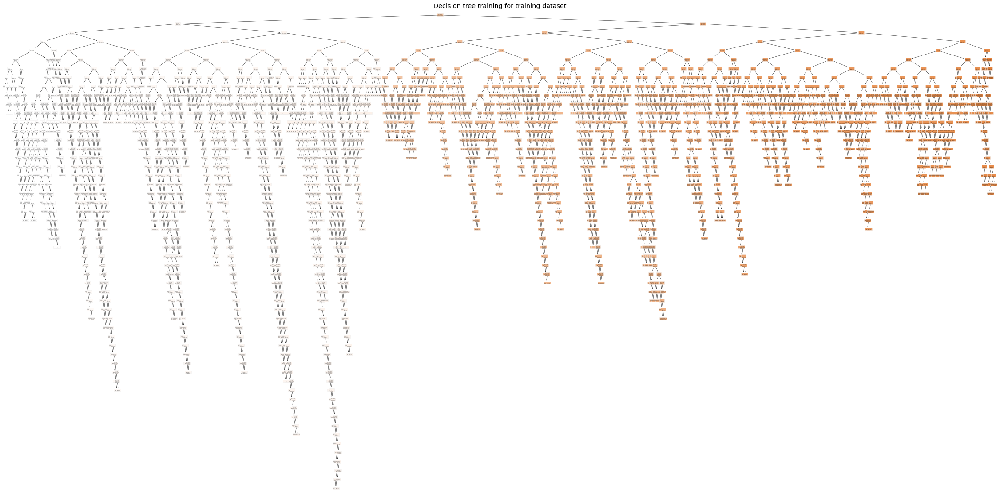

In [224]:
# importing the plot tree method
from sklearn.tree import DecisionTreeRegressor, plot_tree
clf = DecisionTreeRegressor()

# output size of decision tree
plt.figure(figsize=(40,20))

# providing the training dataset
clf = clf.fit(X_train, y_train)
plot_tree(clf, filled=True)
plt.title("Decision tree training for training dataset")
plt.show()

# Visualising Decision Tree (Testing Dataset)using Sklearn

In [ ]:
# importing the plot tree method
from sklearn.tree import DecisionTreeRegressor, plot_tree
clf = DecisionTreeRegressor()

# output size of decision tree
plt.figure(figsize=(40,20))

# providing the training dataset
clf = clf.fit(X_test, y_test)
plot_tree(clf, filled=True)
plt.title("Decision tree training for training dataset")
plt.show()

# Decision Tree Text based Tree

In [ ]:
# importing the tree
from sklearn import tree

# text based tree
text_representation = tree.export_text(clf)
print(text_representation)